In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt


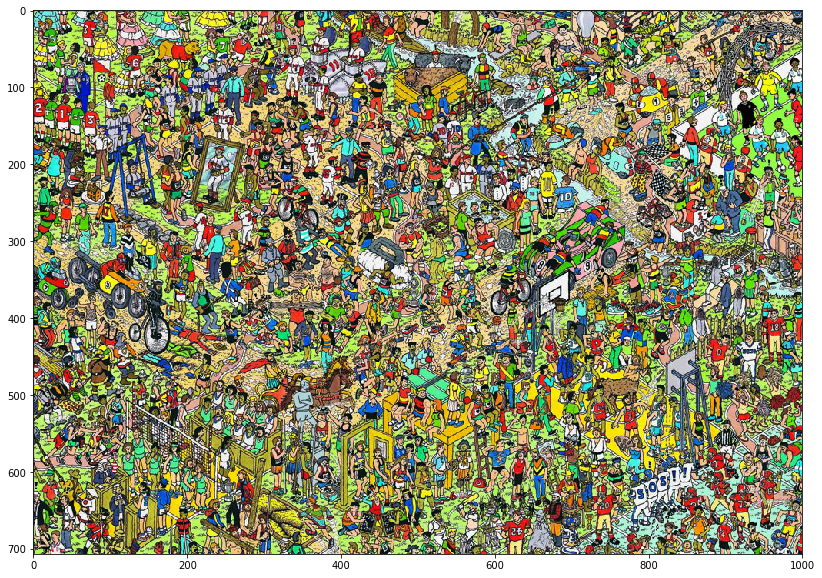

In [2]:
img = cv2.imread("./Data/puzzle_small.jpg", 1)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20, 10))
plt.imshow(img)

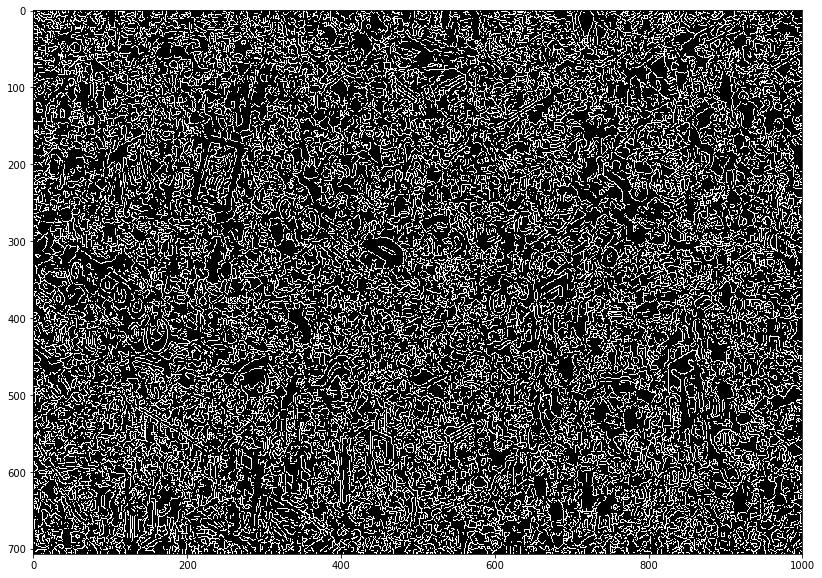

In [3]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray_img = gray
gray = cv2.GaussianBlur(gray, (5,5), 3)
edges = cv2.Canny(gray,50,150,apertureSize = 3)
plt.figure(figsize=(20, 10))
plt.imshow(edges, cmap="gray")

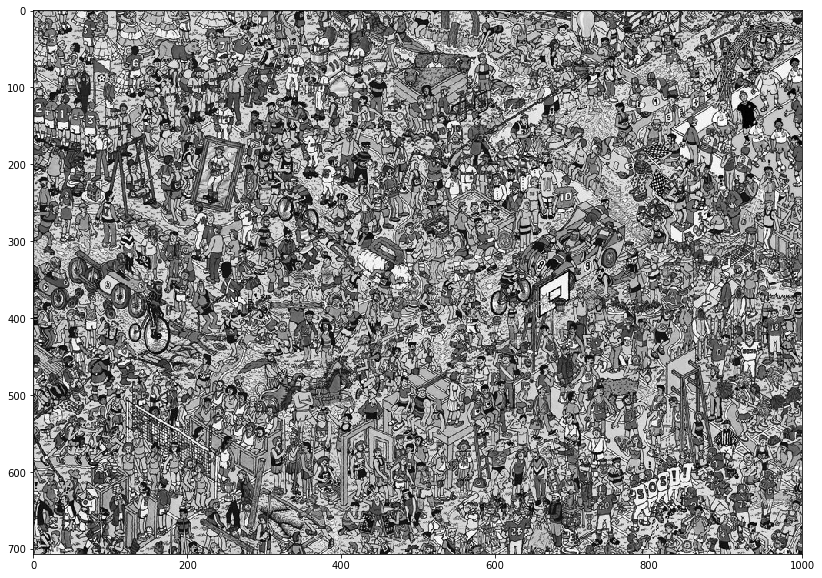

In [4]:
plt.figure(figsize=(20,10))
plt.imshow(gray_img, cmap="gray")

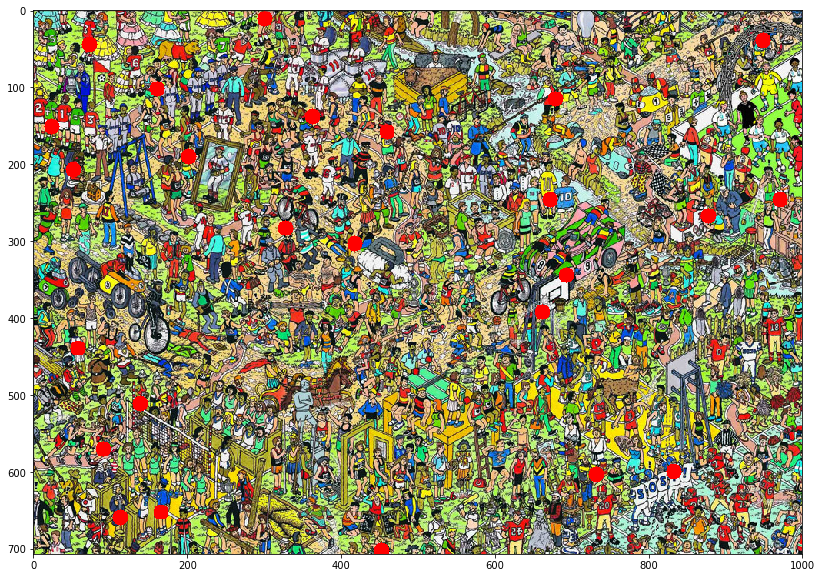

(<matplotlib.image.AxesImage at 0x11745a198>, None)

In [5]:
corners = cv2.goodFeaturesToTrack(gray,25,0.01,10)
corners = np.int0(corners)
for i in corners:
    x,y = i.ravel()
    cv2.circle(img,(x,y),10,255,-1)
plt.figure(figsize=(20,10))
plt.imshow(img),plt.show()

In [6]:
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

No detection


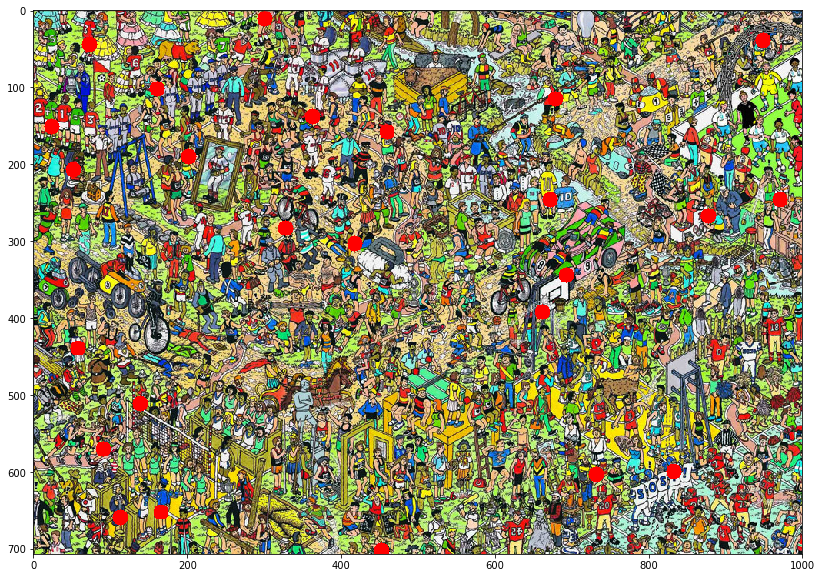

In [7]:
image = cv2.resize(img, (min(800, img.shape[1]), min(600, img.shape[0])), interpolation = cv2.INTER_LINEAR)
#image = cv2.resize(image, (min(1200, image.shape[1]), min(900, image.shape[0])), interpolation = cv2.INTER_LINEAR)

(rects, weights) = hog.detectMultiScale(image, winStride=(4, 4), padding=(0, 0), scale=1.01)
if len(rects) == 0:
        print("No detection")
else:
    rects = np.array([[x, y, x + w, y + h] for (x, y, w, h) in rects])
    pick = non_max_suppression(rects, probs=None, overlapThresh=0.65)

    for (xA, yA, xB, yB) in pick:
        cv2.rectangle(image, (xA, yA), (xB, yB), (0, 255, 0), 2)
plt.figure(figsize=(20,10))
plt.imshow(img)


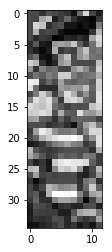

In [8]:
template = cv2.imread("./Data/waldo.jpeg", 1)
template = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)
plt.imshow(template)
plt
template = template[:150,:]
template = img[570:605, 100:112]
template = cv2.cvtColor(template, cv2.COLOR_RGB2GRAY)
plt.imshow(template, cmap="gray")

0.53629595


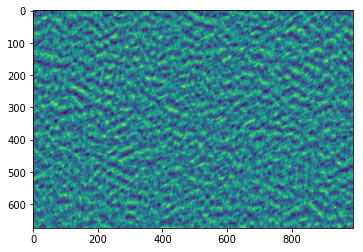

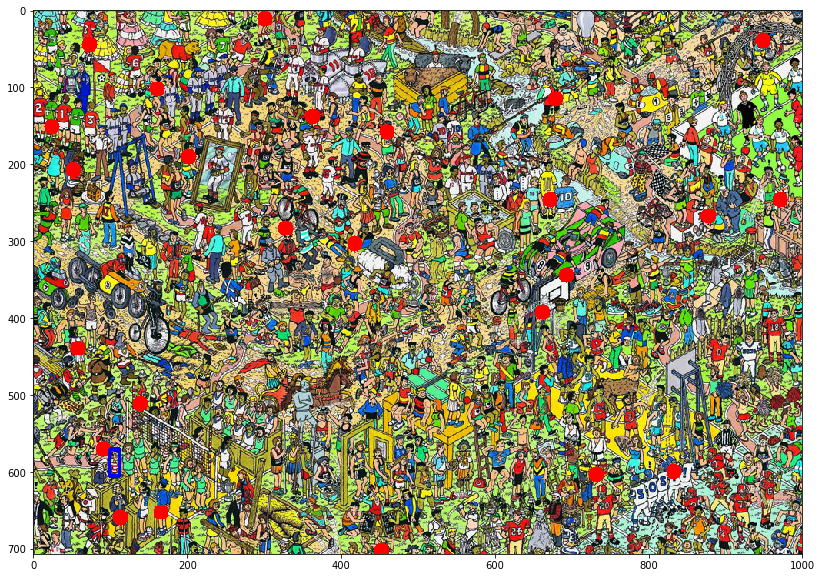

In [9]:
from copy import deepcopy
image = deepcopy(img)
w, h = template.shape
res = cv2.matchTemplate(gray,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.5
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

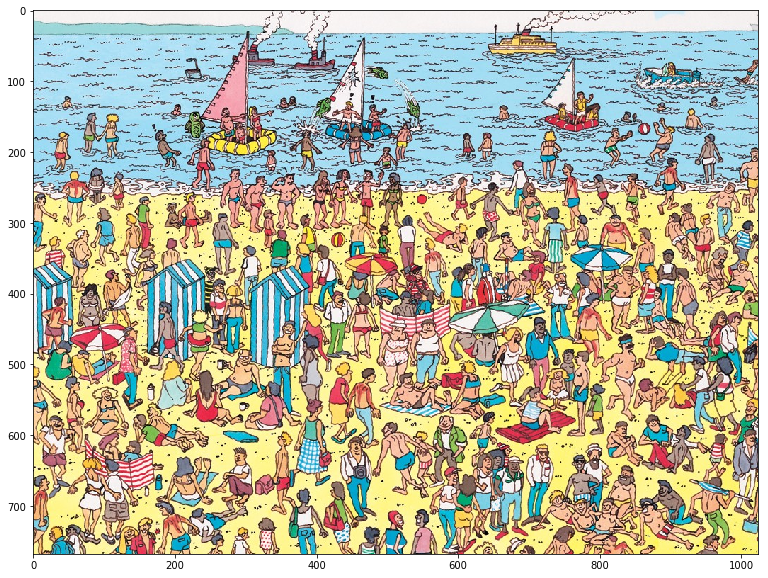

In [10]:
image2 = cv2.imread("./Data/wherewaldo2.jpg", 1)
image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)
gray2 = cv2.cvtColor(image2, cv2.COLOR_RGB2GRAY)
plt.figure(figsize=(20, 10))
plt.imshow(image2)

0.43260896


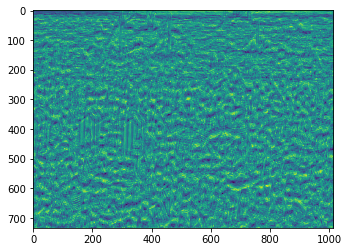

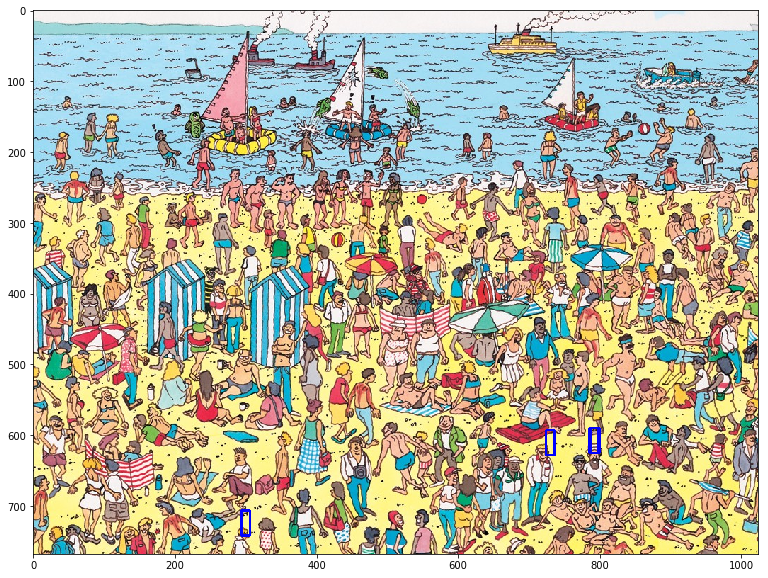

In [11]:
image = deepcopy(image2)
w, h = template.shape
res = cv2.matchTemplate(gray2,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.4
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

(55, 50, 3)


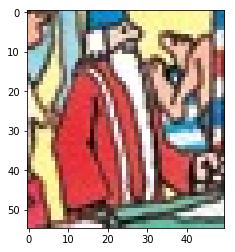

In [12]:
wizard = image2[365:420,620:670]
print(wizard.shape)
plt.imshow(wizard)

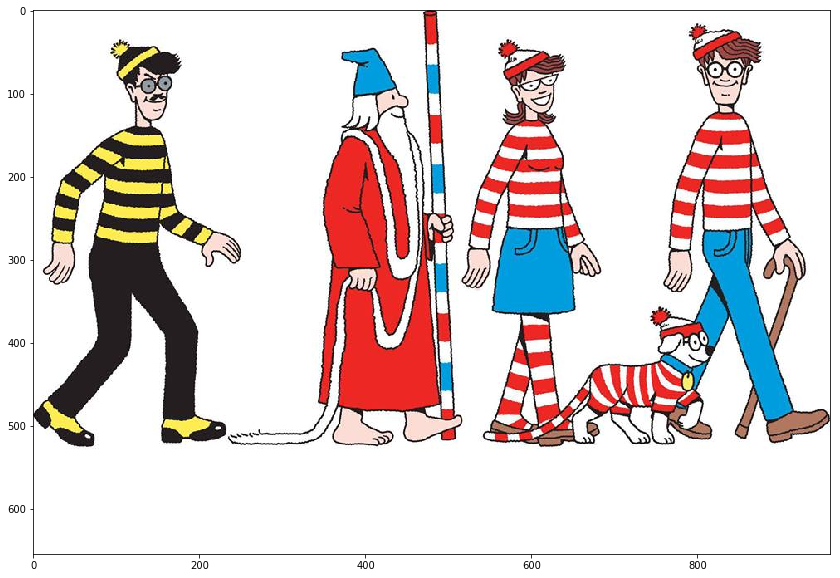

In [13]:
templates = cv2.imread("./Data/waldo_templates.jpg", 1)
templates = cv2.cvtColor(templates, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,10))
plt.imshow(templates)

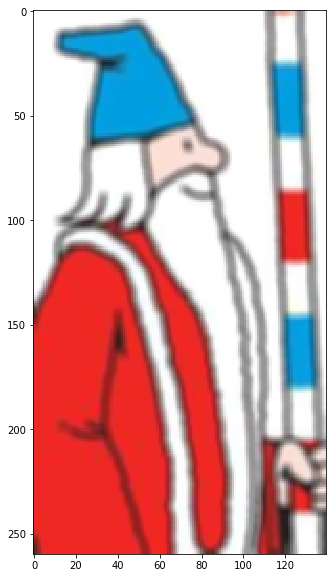

In [14]:
wizard = templates[40:300, 360:500]
wizard = cv2.GaussianBlur(wizard, (5,5), 3)
plt.figure(figsize=(20, 10))
plt.imshow(wizard)

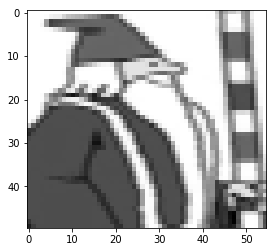

In [15]:
gray_wizard = cv2.cvtColor(wizard, cv2.COLOR_RGB2GRAY)
gray_wizard = cv2.resize(gray_wizard, (55, 50), interpolation= cv2.INTER_LINEAR)
plt.imshow(gray_wizard, cmap="gray")

In [16]:
def find_wizard(method, threshold):
    meth = eval(method)
    image = deepcopy(image2)
    w, h = gray_wizard.shape
    res = cv2.matchTemplate(-gray2,gray_wizard,meth)
    plt.imshow(res)
    print(np.max(res))
    loc = np.where( res >= threshold)
    for pt in zip(*loc[::-1]):
        cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
    plt.figure(figsize=(20, 10))
    plt.imshow(image)
    plt.title(method)
    plt.show()

5201644.0


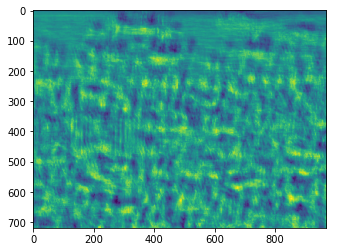

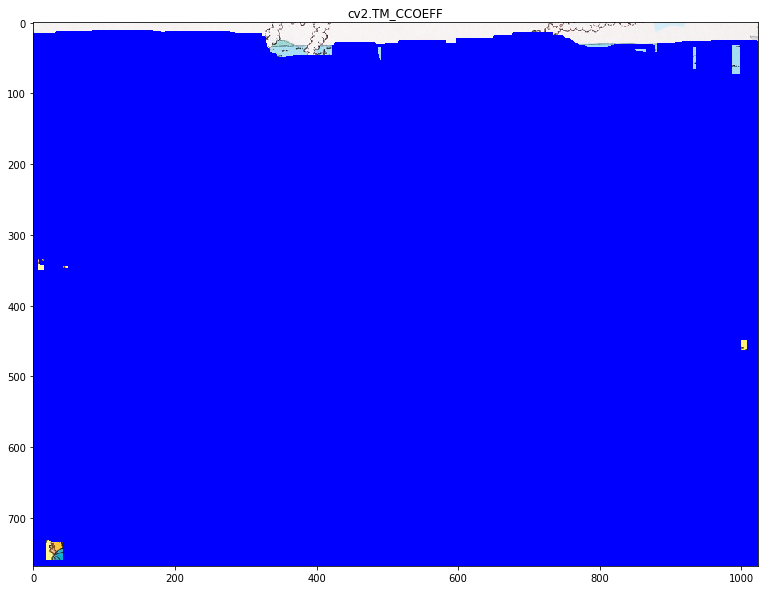

0.39973998


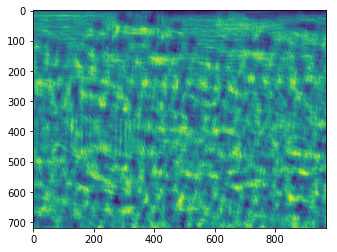

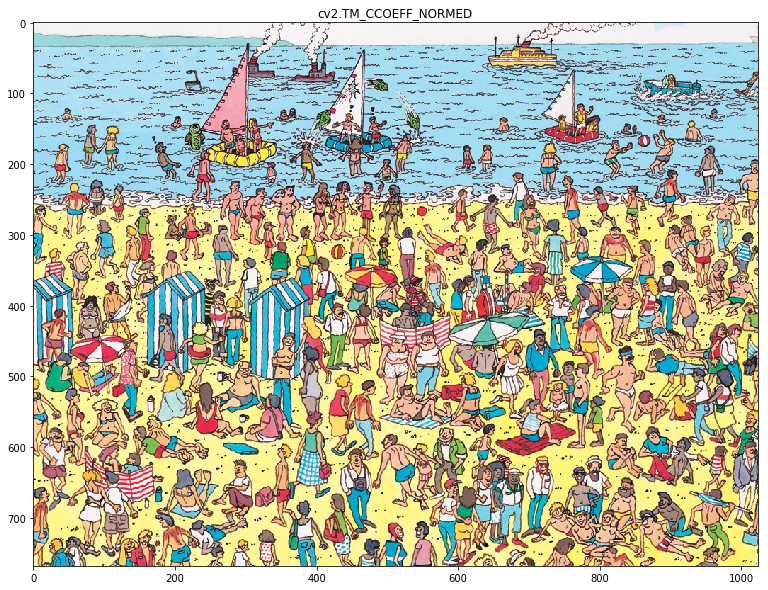

65494220.0


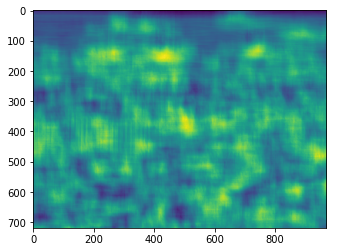

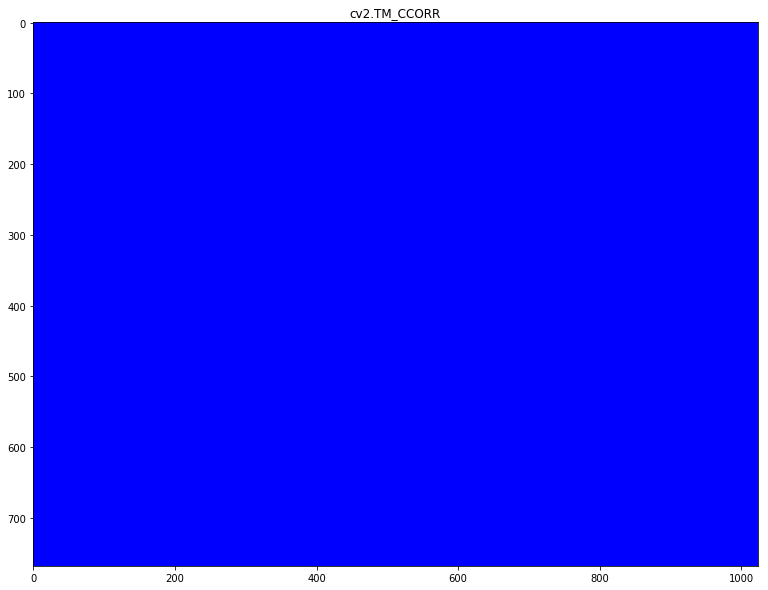

0.89039505


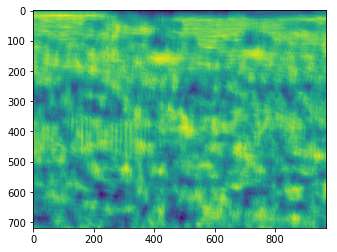

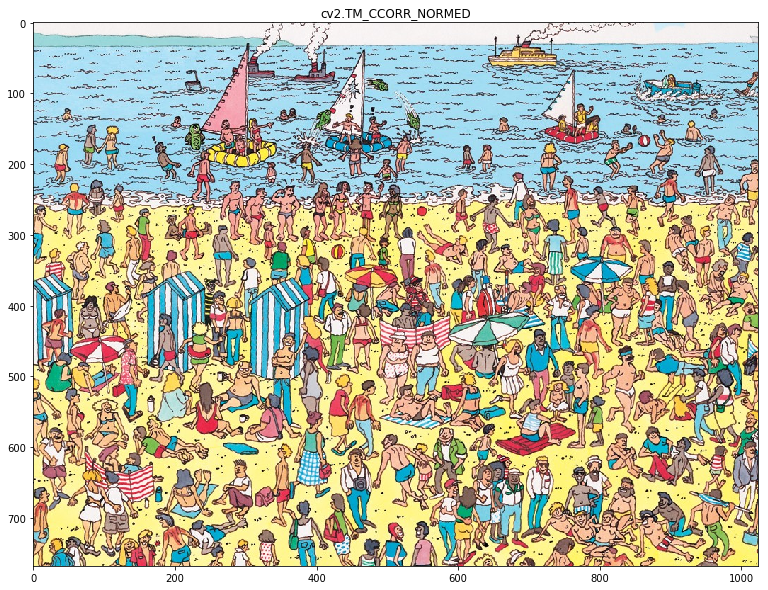

73511960.0


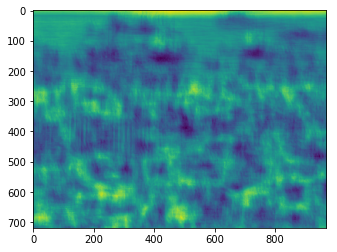

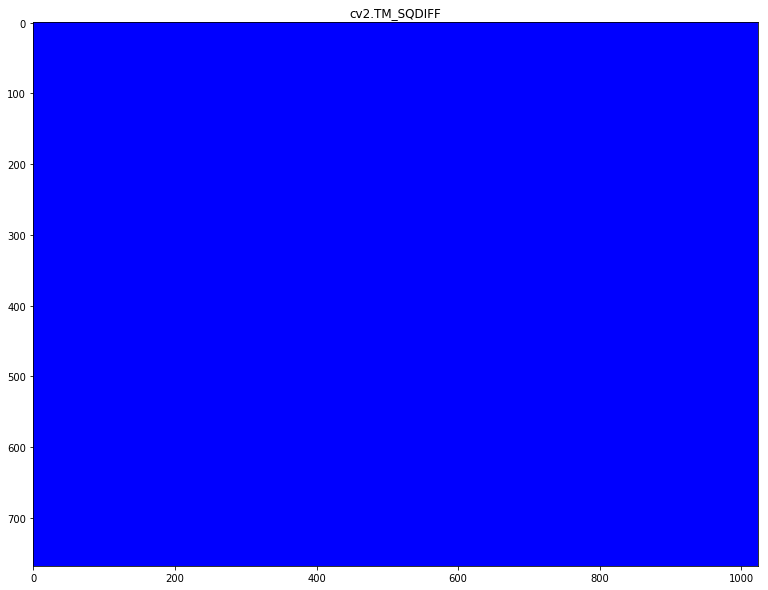

1.0


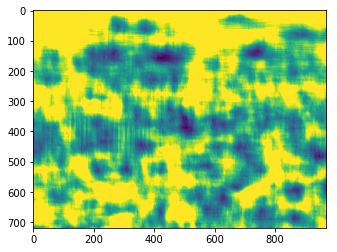

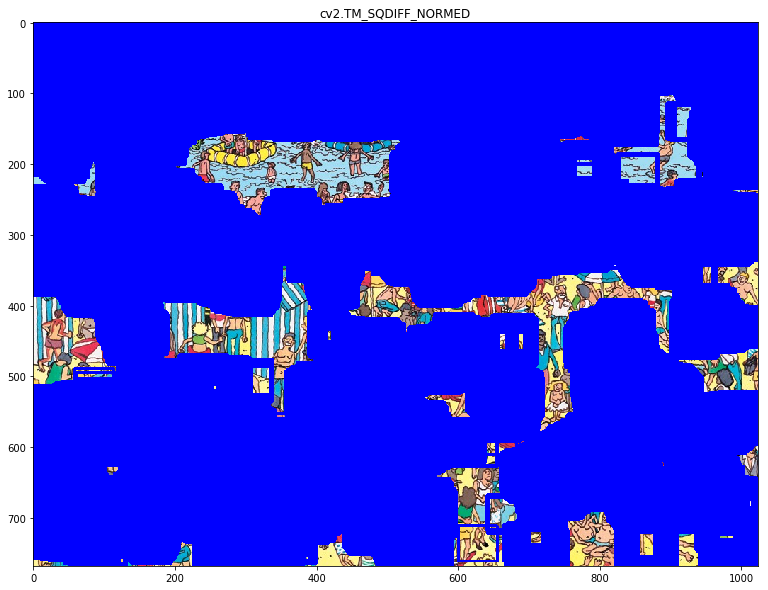

In [17]:
methods = ['cv2.TM_CCOEFF', 'cv2.TM_CCOEFF_NORMED', 'cv2.TM_CCORR',
            'cv2.TM_CCORR_NORMED', 'cv2.TM_SQDIFF', 'cv2.TM_SQDIFF_NORMED']
for method in methods:
    find_wizard(method, 0.9)

1.0


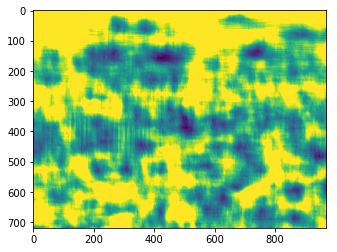

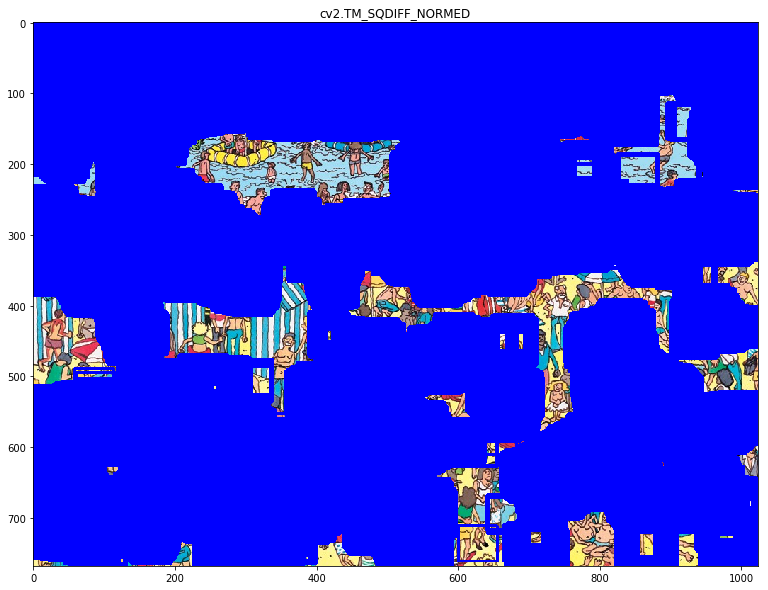

In [18]:
find_wizard('cv2.TM_SQDIFF_NORMED', threshold = 0.9)

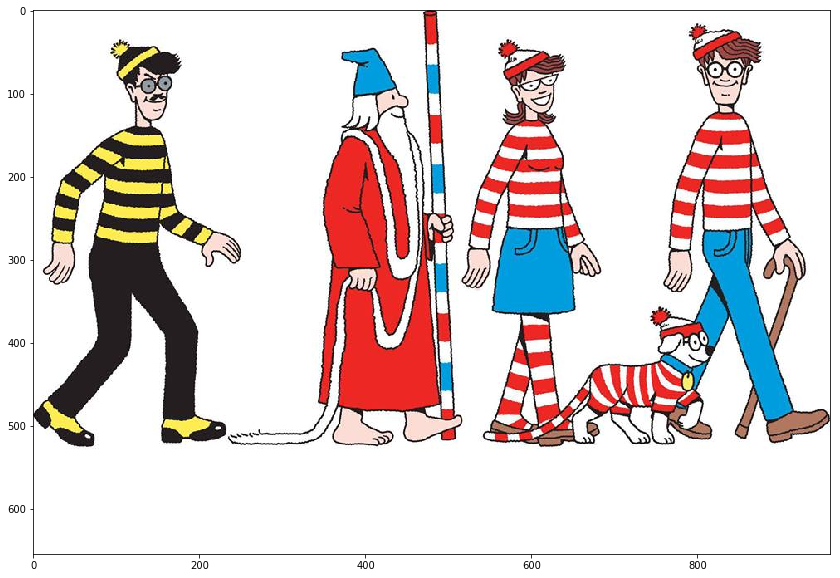

In [19]:
templates = cv2.imread("./Data/waldo_templates.jpg", 1)
templates = cv2.cvtColor(templates, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,10))
plt.imshow(templates)

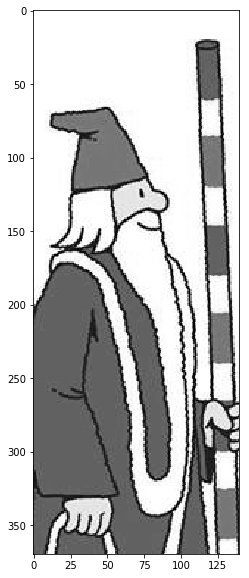

In [20]:
wizard = templates[:350, 360:500]
# wizard = cv2.GaussianBlur(wizard, (5,5), 3)
gwizard = cv2.cvtColor(wizard, cv2.COLOR_RGB2GRAY)
plt.figure(figsize=(20, 10))
plt.imshow(gwizard, cmap="gray")
w, h = gwizard.shape
new_wizard = np.zeros((w+20, h), dtype=np.uint8)
for i in range(new_wizard.shape[0]):
    for j in range(new_wizard.shape[1]):
        if i < 20:
            new_wizard[i,j] = 255
        else:
            new_wizard[i,j] = gwizard[i-20, j]
plt.imshow(new_wizard, cmap="gray")

In [21]:
new_wizard_template = np.zeros((wizard.shape[0] + 20, wizard.shape[1], wizard.shape[2]), dtype=np.uint8)
for i in range(new_wizard_template.shape[0]):
    for j in range(new_wizard_template.shape[1]):
        if i < 20:
            new_wizard_template[i,j][0] = wizard[0,0][0]
            new_wizard_template[i,j][1] = wizard[0,0][1]
            new_wizard_template[i,j][2] = wizard[0,0][2]
        else:
            new_wizard_template[i,j][0] = wizard[i-20,j][0]
            new_wizard_template[i,j][1] = wizard[i-20,j][1]
            new_wizard_template[i,j][2] = wizard[i-20,j][2]

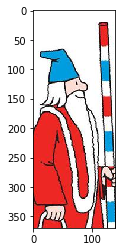

In [22]:
plt.imshow(new_wizard_template)

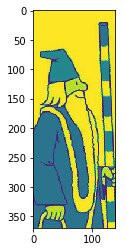

In [23]:
plt.imshow(new_wizard)

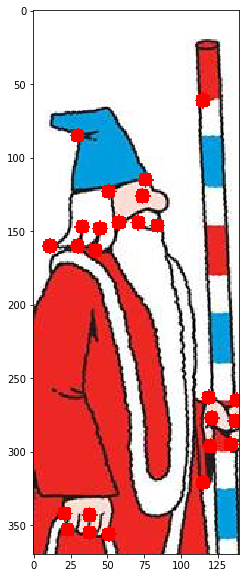

In [24]:
wizard2 = deepcopy(new_wizard_template)
corners = cv2.goodFeaturesToTrack(new_wizard,25,0.01,10)
corners = np.int0(corners)
for i in corners:
    x,y = i.ravel()
    cv2.circle(wizard2,(x,y),5,255,-1)
plt.figure(figsize=(20,10))
plt.imshow(wizard2)
plt.show()

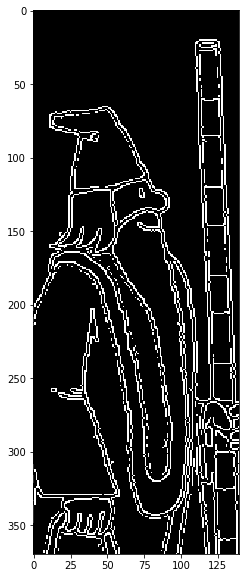

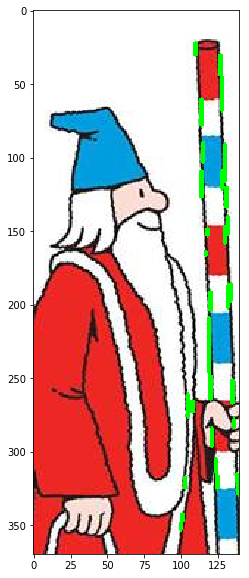

In [25]:
image3 = deepcopy(new_wizard_template)
edges = cv2.Canny(new_wizard,50,150,apertureSize = 3)
plt.figure(figsize=(20,10))
plt.imshow(edges, cmap="gray")
plt.show()

lines = []
minLineLength = 5
maxLineGap = 20
lines = cv2.HoughLinesP(edges,1,np.pi/180,100)
for line in lines:
    for x1,y1,x2,y2 in line:
        cv2.line(image3,(x1,y1),(x2,y2),(0,255,0),2)
plt.figure(figsize=(20, 10))
plt.imshow(image3)
plt.show()

(1080, 1920, 3)


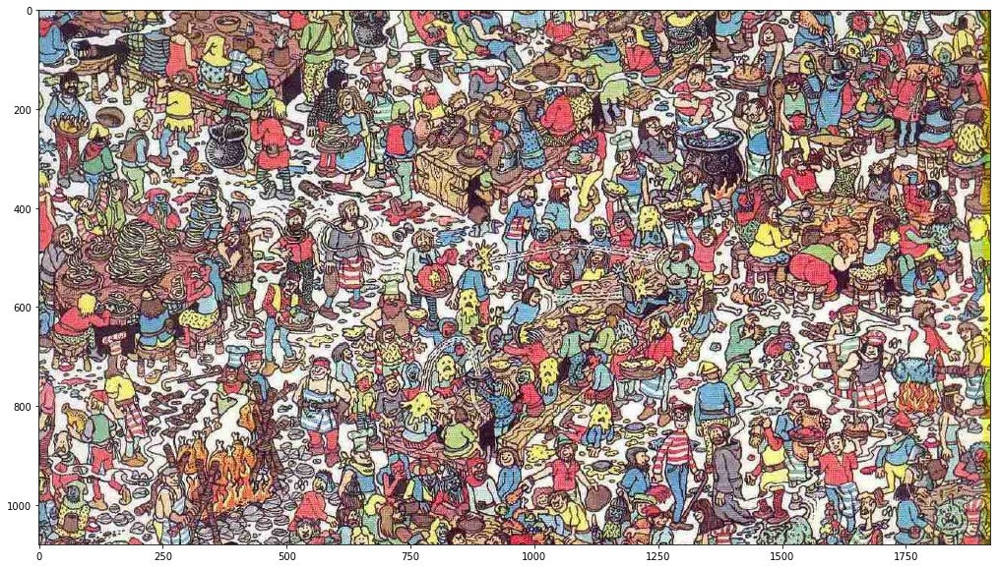

In [26]:
img = cv2.imread('./Data/highdefwaldo.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print(img.shape)
plt.figure(figsize=(20,10))
plt.imshow(img)

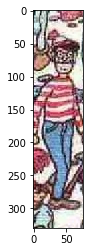

In [27]:
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
waldo = img[750:1080, 1250:1325]
gray_waldo = cv2.cvtColor(waldo, cv2.COLOR_RGB2GRAY)
plt.imshow(waldo)

1.0


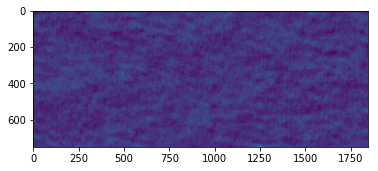

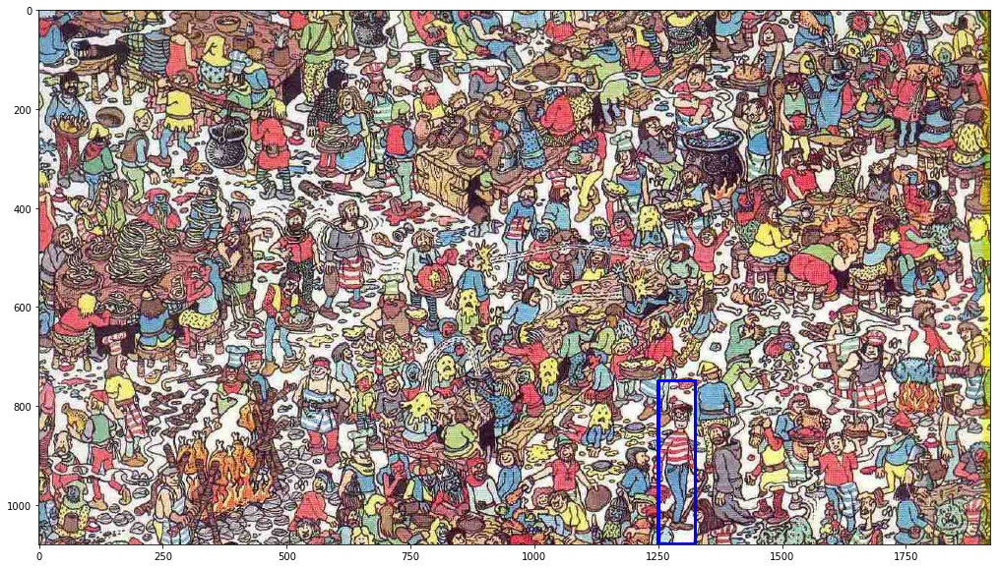

In [28]:
from copy import deepcopy
image = deepcopy(img)
template = gray_waldo
w, h = template.shape
res = cv2.matchTemplate(gray,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.5
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

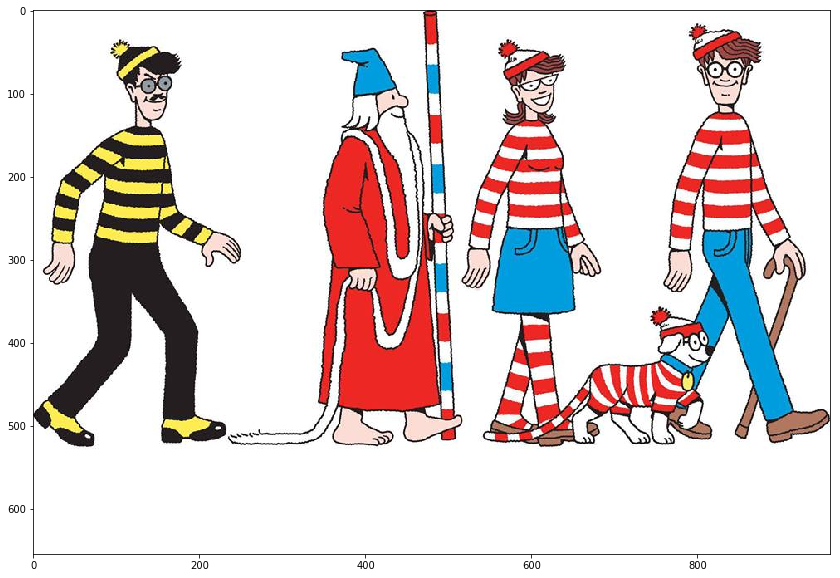

In [29]:
templates = cv2.imread("./Data/waldo_templates.jpg", 1)
templates = cv2.cvtColor(templates, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(20,10))
plt.imshow(templates)

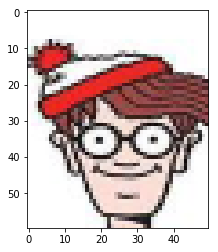

In [30]:
waldo_head = templates[0:120, 790:870]
waldo_head = cv2.resize(waldo_head, (50, 60))
gray_head = cv2.cvtColor(waldo_head, cv2.COLOR_RGB2GRAY)
plt.imshow(waldo_head)

0.4912808


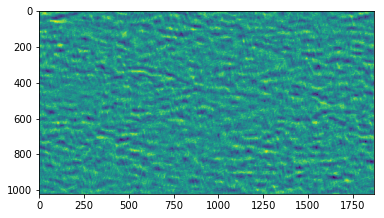

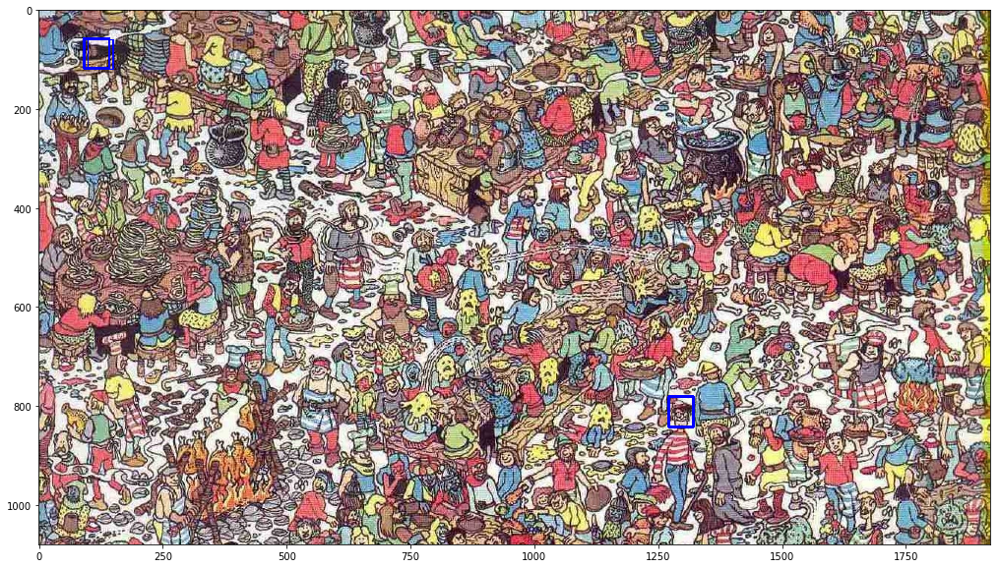

In [31]:
image = deepcopy(img)
template = gray_head
w, h = template.shape
res = cv2.matchTemplate(gray,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.45
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

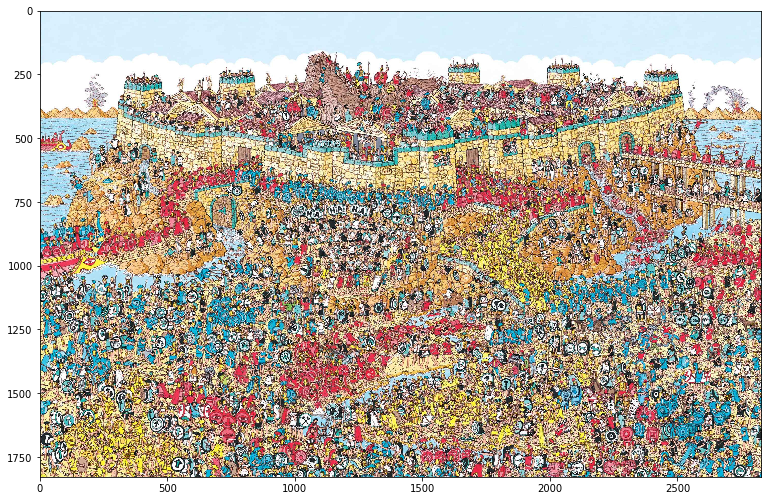

In [32]:
new_img = cv2.imread("./Data/superbigwhereswaldo.jpg", 1)
new_img = cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB)
ratio = new_img.shape[0]/new_img.shape[1]
plt.figure(figsize=(20*ratio, 20))
plt.imshow(new_img)

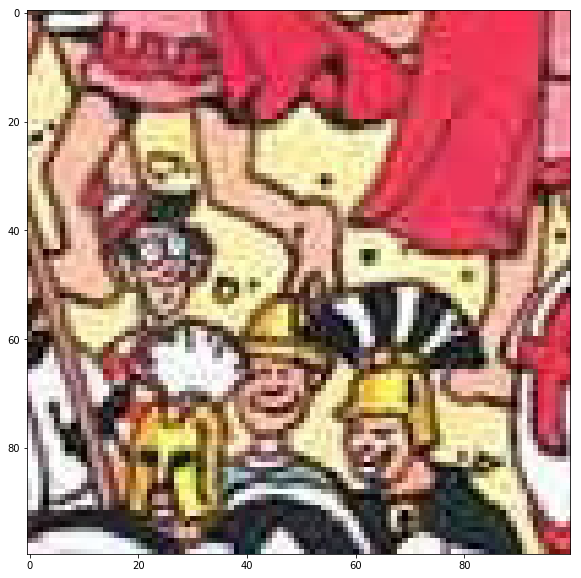

In [33]:
test = new_img[1500:1600,450:550]
plt.figure(figsize=(20, 10))
plt.imshow(test)

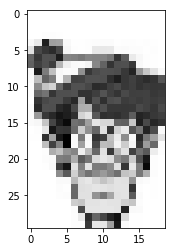

In [34]:
gray_img = cv2.cvtColor(new_img, cv2.COLOR_RGB2GRAY)
waldo_ratio = waldo_head.shape[0]/waldo_head.shape[1]
waldo_head_2 = cv2.resize(waldo_head, (int(30*ratio), 30))
gray_head_2 = cv2.cvtColor(waldo_head_2, cv2.COLOR_RGB2GRAY)
plt.imshow(gray_head_2, cmap="gray")

0.62661505


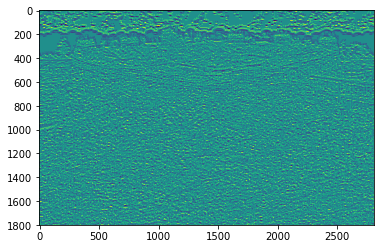

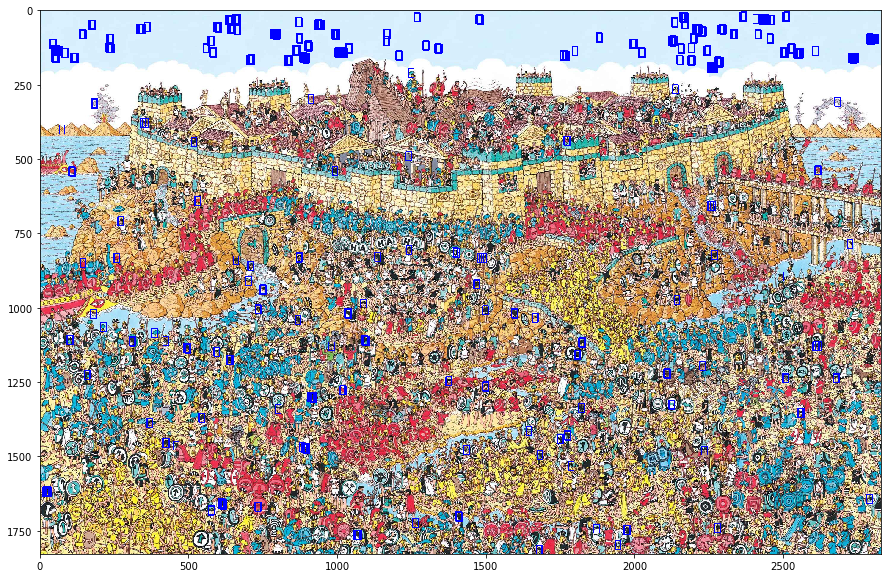

In [35]:
image = deepcopy(new_img)
template = gray_head_2
w, h = template.shape
res = cv2.matchTemplate(gray_img,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.45
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

In [36]:
lotsawaldos = cv2.imread("./Data/loadsofwaldos.jpg", 1)
lotsawaldos = cv2.cvtColor(lotsawaldos, cv2.COLOR_BGR2RGB)
lotsawaldos_gray = cv2.cvtColor(lotsawaldos, cv2.COLOR_RGB2GRAY)

0.4618433


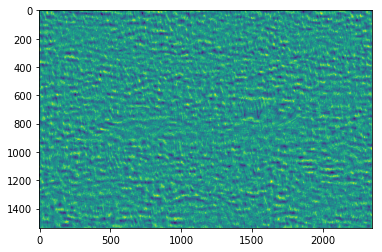

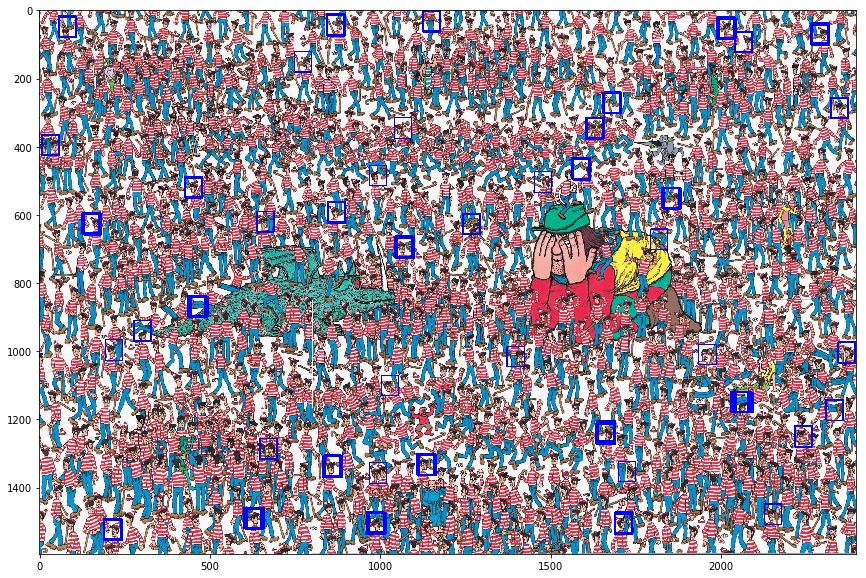

In [37]:
image = deepcopy(lotsawaldos)
template = gray_head
w, h = template.shape
res = cv2.matchTemplate(lotsawaldos_gray ,template,cv2.TM_CCOEFF_NORMED)
plt.imshow(res)
threshold = 0.35
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(image)

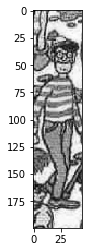

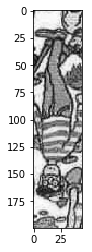

In [38]:
ratio = waldo.shape[0] / waldo.shape[1]
new_gray_waldo = cv2.resize(gray_waldo, (int(200/ratio), 200))
plt.imshow(new_gray_waldo, cmap="gray")
plt.show()
plt.imshow(cv2.flip(new_gray_waldo, 1), cmap="gray")
wonky_grey_waldo = cv2.flip(new_gray_waldo, -1)
plt.imshow(wonky_grey_waldo, cmap="gray")

0.25725868
0.25440097


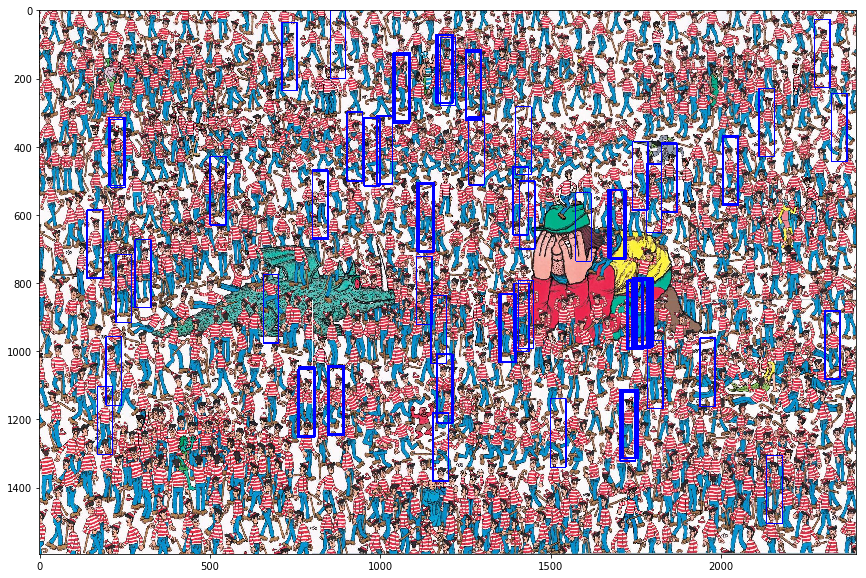

In [39]:
image = deepcopy(lotsawaldos)
template = new_gray_waldo
w, h = template.shape
res = cv2.matchTemplate(lotsawaldos_gray ,template,cv2.TM_CCOEFF_NORMED)
# plt.imshow(res)
threshold = 0.20
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
template = cv2.flip(new_gray_waldo, 1)
w, h = template.shape
res = cv2.matchTemplate(lotsawaldos_gray ,template,cv2.TM_CCOEFF_NORMED)
# plt.imshow(res)
threshold = 0.20
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)

plt.figure(figsize=(20, 10))
plt.imshow(image)

In [72]:
jumper_mask = np.zeros((50, 10, 3), dtype=np.uint8)
width = 20
red = True
for i in range(jumper_mask.shape[0]):
    for j in range(jumper_mask.shape[1]):
        if red:
            jumper_mask[i,j] = [255, 0, 0]
        else:
            jumper_mask[i,j] = [255, 255, 255]
    if i % width == 0:
        red = not red


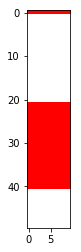

In [73]:
plt.imshow(jumper_mask)

0.6208366


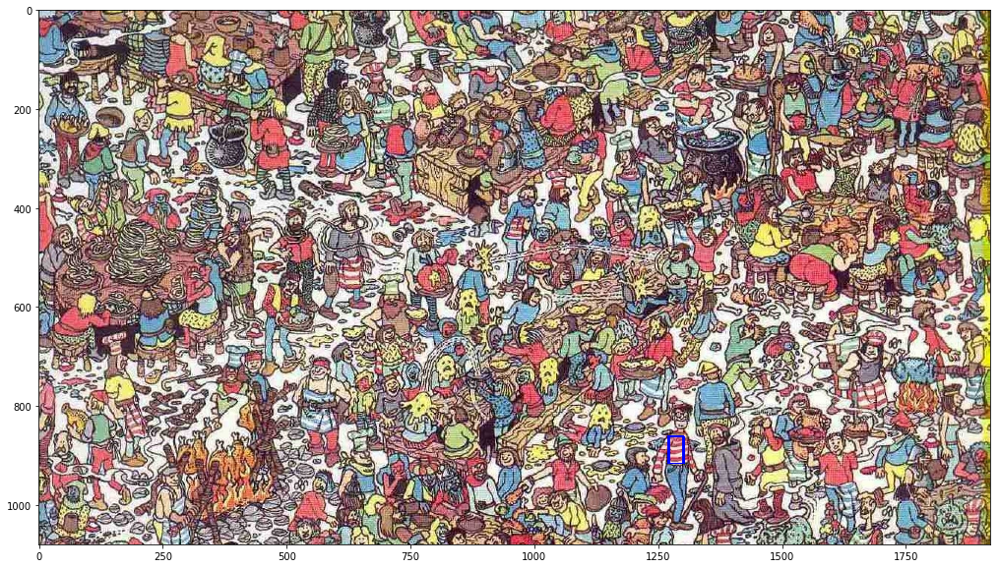

In [114]:
img = cv2.imread('./Data/highdefwaldo.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
template = cv2.cvtColor(jumper_mask, cv2.COLOR_RGB2GRAY)
w, h = template.shape
res = cv2.matchTemplate(gray ,template,cv2.TM_CCOEFF_NORMED)
# plt.imshow(res)
threshold = 0.6
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(img, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(img)

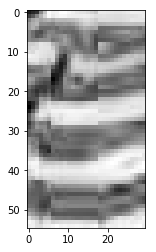

In [120]:
img = cv2.imread('./Data/highdefwaldo.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
jumper = img[860:915, 1270:1300]
gjumper = cv2.cvtColor(jumper, cv2.COLOR_RGB2GRAY)
plt.imshow(gjumper, cmap="gray")

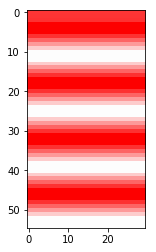

In [145]:
jumper_mask = np.zeros((55, 30, 3), dtype=np.uint8)
width = 7
red = False
for i in range(jumper_mask.shape[0]):
    for j in range(jumper_mask.shape[1]):
        if red:
            jumper_mask[i,j] = [255, 0, 0]
        else:
            jumper_mask[i,j] = [255, 255, 255]
    if i % width == 0:
        red = not red
jumper_mask = cv2.GaussianBlur(jumper_mask, (5,5), 5)
gray_mask = cv2.cvtColor(jumper_mask, cv2.COLOR_RGB2GRAY)
plt.imshow(jumper_mask, cmap="gray")

0.6208366


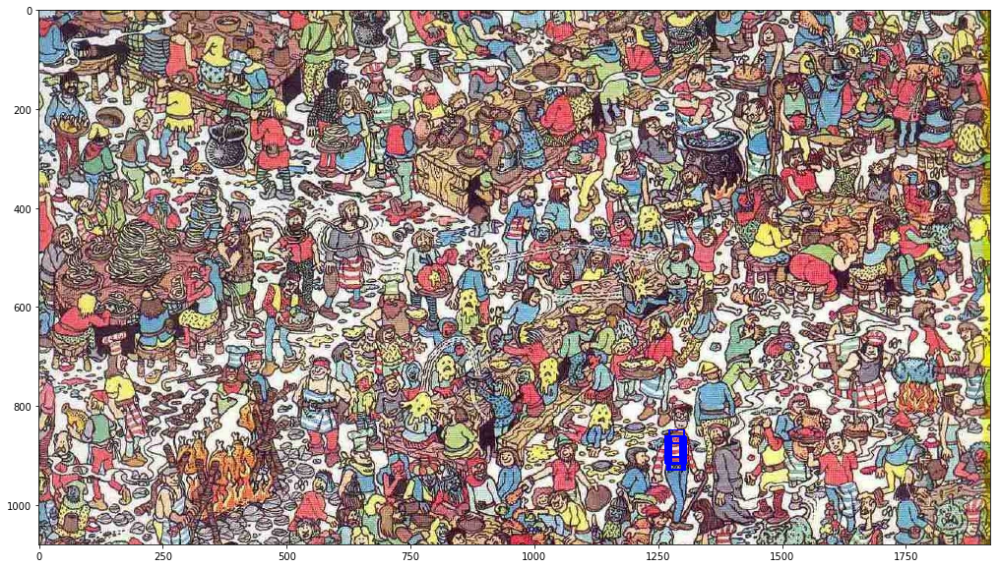

In [147]:
new_img = cv2.imread('./Data/highdefwaldo.jpg', 1)
new_img = cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(new_img, cv2.COLOR_RGB2GRAY)
template = cv2.cvtColor(jumper_mask, cv2.COLOR_RGB2GRAY)
w, h = template.shape
res = cv2.matchTemplate(gray ,template,cv2.TM_CCOEFF_NORMED)
# plt.imshow(res)
threshold = 0.5
print(np.max(res))
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(new_img, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
plt.figure(figsize=(20, 10))
plt.imshow(new_img)

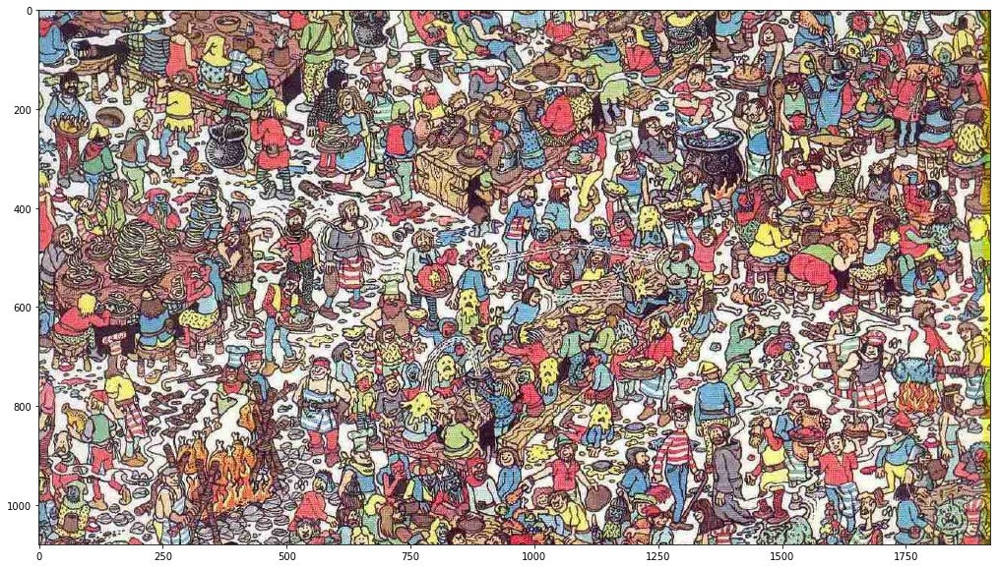

In [144]:
new_img = cv2.imread('./Data/highdefwaldo.jpg', 1)
new_img = cv2.cvtColor(new_img, cv2.COLOR_BGR2RGB)
match_points = []
for pt in zip(*loc[::-1]):
    match_points.append(pt)

point = match_points[0]
waldo_zones = []
for point in match_points:
    x = point[0]
    y = point[1]
    # print(x,y)
    waldo_zone = new_img[y-100:y+100, x-100: x+100]
    waldo_zones.append(waldo_zone)
    h = 100
    # used to plot the zones
    # cv2.rectangle(new_img, (x-h,y-h), (x+h, y+h), (0,0,255), 3)
# plt.figure(figsize=(20, 10))
# plt.imshow(new_img)
    

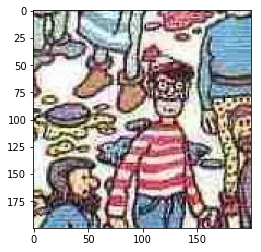

In [148]:
test_zone = waldo_zones[0]
plt.imshow(test_zone)

0.4912808


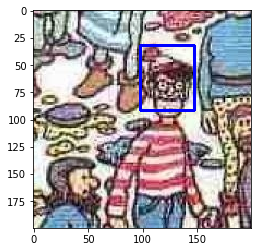

In [153]:
image = deepcopy(test_zone)
gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
template = gray_head
w, h = template.shape
res = cv2.matchTemplate(gray_image ,template,cv2.TM_CCOEFF_NORMED)
print(np.max(res))
threshold = 0.45
loc = np.where( res >= threshold)
for pt in zip(*loc[::-1]):
    cv2.rectangle(image, pt, (pt[0] + h, pt[1] + w), (0,0,255), 2)
    break
plt.imshow(image)